<a href="https://colab.research.google.com/github/apolaf44/GeneralRepository/blob/main/RockingData_PythonChallenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **1.1 Instalacion/Importacion de Librerias**

In [1]:
import pandas as pd
import numpy as np

Data Visualization

In [2]:
import seaborn as sns
sns.set_style('darkgrid')
import matplotlib.pyplot as plt
#from matplotlib import font_manager as fm , rcParams # 

In [3]:
#pd.options.display.max_columns = None

Pandas Profiling

In [4]:
pip install -U https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached https://github.com/pandas-profiling/pandas-profiling/archive/master.zip (21.9 MB)


Klib : Limpieza de Datos

In [5]:
! pip install klib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


Imbalanced-learn : Balanceo de datos

In [6]:
! pip install -U imbalanced-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached imbalanced_learn-0.9.1-py3-none-any.whl (199 kB)


In [7]:
pip install imbalanced-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [8]:
import imblearn
from imblearn.under_sampling import RandomUnderSampler

In [9]:
pip install sklearn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# **2.1. Extraccion de datos**

In [12]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [13]:
bank_df = pd.read_excel('/content/drive/MyDrive/DATA SCIENCE/Challenge   RockingData-Python/Challenge:RockingData-PYTHON/bank-additional-full 22.xlsx')

# **3.1. EDA : Clásico**

Buscamos si tenemos Valores Nulos

In [14]:
bank_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

*Primeros registros del dataframe*

In [15]:
bank_df.head(10)

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
5,45,services,married,basic.9y,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
6,59,admin.,married,professional.course,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
7,41,blue-collar,married,unknown,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
8,24,technician,single,professional.course,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no
9,25,services,single,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.4,4857.0,5191.0,no


Observamos su forma:"                                          bank_df " tiene 41188 FILAS & 21 COLUMNAS

In [16]:
bank_df.shape

(41188, 21)

*Tipos de datos*

In [17]:
bank_df.dtypes

age                 int64
job                object
marital            object
education          object
default            object
housing            object
loan               object
contact            object
month              object
day_of_week        object
duration            int64
campaign            int64
pdays               int64
previous            int64
poutcome           object
emp.var.rate      float64
cons.price.idx    float64
cons.conf.idx     float64
euribor3m         float64
nr.employed       float64
y                  object
dtype: object

In [18]:
#bank_df['day_of_week'] = pd.to_datetime(bank_df.day_of_week , errors='ignore', format='%d')

Generamos un rapido análisis descriptivo

In [19]:
bank_df.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41188.00000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000
mean,40.02406,258.285010,2.567593,962.475454,0.172963,0.081886,85401.579955,-40.502600,3180.107207,5167.035911
std,10.42125,259.279249,2.770014,186.910907,0.494901,1.570960,26471.506796,4.628198,2086.690436,72.251528
min,17.00000,0.000000,1.000000,0.000000,0.000000,-3.400000,93.200000,-50.800000,0.634000,4963.600000
25%,32.00000,102.000000,1.000000,999.000000,0.000000,-1.800000,92893.000000,-42.700000,1281.000000,5099.100000
50%,38.00000,180.000000,2.000000,999.000000,0.000000,1.100000,93749.000000,-41.800000,4856.000000,5191.000000
75%,47.00000,319.000000,3.000000,999.000000,0.000000,1.400000,93994.000000,-36.400000,4961.000000,5228.100000
max,98.00000,4918.000000,56.000000,999.000000,7.000000,1.400000,94767.000000,-26.900000,5045.000000,5228.100000


# **3.2. EDA : Pandas Profiling**

In [20]:
from pandas_profiling import ProfileReport

In [21]:
df_profile = ProfileReport(bank_df , title='Bank EDA Report' , explorative=True)

In [22]:
# Exploracion
df_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# **4.1. Data Cleaning: Libreria "klib"**

La funcion de ***data_cleaning( )*** elimina los valores vacios y duplicados en columnas

In [23]:
from klib.clean import data_cleaning

In [24]:
# Borramos las Columnas Duplicadas (12)
# Y se reduce el uso de memoria en un %-74.39
data_cleaning(bank_df)

Shape of cleaned data: (41176, 21)Remaining NAs: 0

Changes:
Dropped rows: 12
     of which 12 duplicates. (Rows: [1266, 12261, 14234, 16956, 18465, 20216, 20534, 25217, 28477, 32516, 36951, 38281])
Dropped columns: 0
     of which 0 single valued.     Columns: []
Dropped missing values: 0
Reduced memory by at least: 4.91 MB (-74.39%)



,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp_var_rate,cons_price_idx,cons_conf_idx,euribor3m,nr_employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.400002,4857.0,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.400002,4857.0,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.400002,4857.0,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.400002,4857.0,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93994.0,-36.400002,4857.0,5191.0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
41171,73,retired,married,professional.course,no,yes,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94767.0,-50.799999,1028.0,4963.600098,yes
41172,46,blue-collar,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94767.0,-50.799999,1028.0,4963.600098,no
41173,56,retired,married,university.degree,no,yes,no,cellular,nov,fri,...,2,999,0,nonexistent,-1.1,94767.0,-50.799999,1028.0,4963.600098,no
41174,44,technician,married,professional.course,no,no,no,cellular,nov,fri,...,1,999,0,nonexistent,-1.1,94767.0,-50.799999,1028.0,4963.600098,yes


In [25]:
# Guardo el Dataset limpio en uno Nuevo
bank_df = data_cleaning(bank_df)

Shape of cleaned data: (41176, 21)Remaining NAs: 0

Changes:
Dropped rows: 12
     of which 12 duplicates. (Rows: [1266, 12261, 14234, 16956, 18465, 20216, 20534, 25217, 28477, 32516, 36951, 38281])
Dropped columns: 0
     of which 0 single valued.     Columns: []
Dropped missing values: 0
Reduced memory by at least: 4.91 MB (-74.39%)



In [26]:
# Podemos apreciar que ahora nuestro Dataset cuenta con 41176 Filas
bank_df.shape

(41176, 21)

# **Buyer Persona**

In [55]:
yes_clients = bank_df_clean[bank_df_clean['y'] == 'yes']

In [56]:
yes_clients.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,y,cod_job,cod_marital,cod_education,cod_default,cod_housing,cod_loan,cod_contact,cod_poutcome,cod_y
139,45,blue-collar,married,basic.9y,unknown,yes,no,telephone,may,mon,...,yes,1,1,2,1,2,0,1,1,1
1189,46,blue-collar,single,basic.9y,no,yes,no,telephone,may,thu,...,yes,1,2,2,0,2,0,1,1,1
1318,54,admin.,married,university.degree,no,no,no,telephone,may,thu,...,yes,0,1,6,0,0,0,1,1,1
1612,33,services,married,high.school,unknown,no,no,telephone,may,fri,...,yes,7,1,3,1,0,0,1,1,1
2001,59,management,married,university.degree,no,no,no,telephone,may,mon,...,yes,4,1,6,0,0,0,1,1,1


In [57]:
yes_clients.describe()

,age,duration,campaign,pdays,previous,emp_var_rate,cons_price_idx,cons_conf_idx,euribor3m,nr_employed,cod_job,cod_marital,cod_education,cod_default,cod_housing,cod_loan,cod_contact,cod_poutcome,cod_y
count,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.000000,2313.0
mean,38.134025,299.661911,1.783831,22.975789,0.654561,-1.823735,90776.335495,-39.878297,916.577173,5062.845655,4.018158,1.336792,4.519671,0.036749,1.139213,0.309122,0.118893,1.124081,1.0
std,11.359539,123.570556,1.105177,11.196318,0.963206,1.165509,15068.884766,6.253430,1431.908569,70.336670,3.829816,0.634449,1.933514,0.188185,0.979278,0.707711,0.323733,0.633340,0.0
min,17.000000,37.000000,1.000000,0.000000,0.000000,-3.400000,93.199997,-50.799999,0.634000,4963.600098,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.0
25%,29.000000,200.000000,1.000000,9.000000,0.000000,-2.900000,92843.000000,-46.200001,0.797000,5008.700195,0.000000,1.000000,3.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.0
50%,35.000000,283.000000,1.000000,30.000000,0.000000,-1.800000,93075.000000,-40.299999,1.250000,5076.200195,4.000000,1.000000,5.000000,0.000000,2.000000,0.000000,0.000000,1.000000,1.0
75%,47.000000,397.000000,2.000000,30.000000,1.000000,-1.700000,93918.000000,-34.799999,1365.000000,5099.100098,8.000000,2.000000,6.000000,0.000000,2.000000,0.000000,0.000000,2.000000,1.0
max,64.000000,547.000000,6.000000,30.000000,6.000000,1.400000,94767.000000,-29.799999,5045.000000,5228.100098,11.000000,3.000000,7.000000,1.000000,2.000000,2.000000,1.000000,2.000000,1.0


In [58]:
yes_clients_profile = ProfileReport(yes_clients , title='yes_clients EDA Report' , explorative=True)

yes_clients_profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

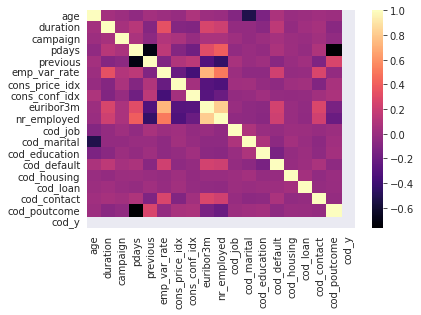

In [59]:
sns.heatmap(yes_clients.corr() , cmap='magma')

# **PREGUNTAS**

## ¿Cuanto duran en PROMEDIO las llamadas en las que el Cliente dijo SI?

In [ ]:
minutos_promedio = (yes_clients['duration'].mean())/60
print('Las llamadas exitosas duran en promedio:', minutos_promedio ,'minutos')

Las llamadas exitosas duran en promedio: 4.994365182302926 minutos


### ¿Cuantos dias habian transcurrido desde el último contacto con el cliente?

### ¿A traves de que medio prefiere ser contactado?

In [ ]:
yes_clients['contact'].value_counts()

cellular     2038
telephone     275
Name: contact, dtype: int64

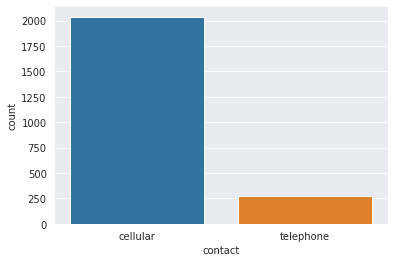

In [ ]:
sns.countplot(x ='contact', data = yes_clients)

## ¿Cuantas veces llamaron a esos Clientes que dijeron SI?


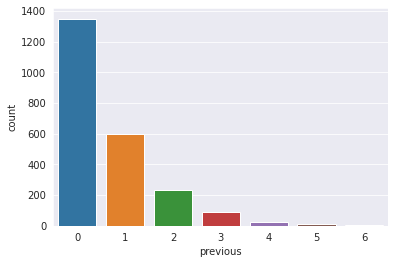

In [ ]:
sns.countplot(x ='previous', data = yes_clients)

# **PreProcesado de Datos**

In [27]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

In [28]:
bank_df['cod_job'] = le.fit_transform(bank_df.job)
bank_df['cod_marital'] = le.fit_transform(bank_df.marital)
bank_df['cod_education'] = le.fit_transform(bank_df.education)
bank_df['cod_default'] = le.fit_transform(bank_df.default)
bank_df['cod_housing'] = le.fit_transform(bank_df.housing)
bank_df['cod_loan'] = le.fit_transform(bank_df.loan)
bank_df['cod_contact'] = le.fit_transform(bank_df.contact)
bank_df['cod_poutcome'] = le.fit_transform(bank_df.poutcome)
bank_df['cod_y'] = le.fit_transform(bank_df.y)

In [29]:
# Cambie el 999 porque me parecia un Valor Totalmente exagerado y le asigne un 30 dias de màx
bank_df['pdays'] =  bank_df['pdays'].replace(to_replace=999 , value = 30 )

# **Outliers**

Gráfico de Boxplot para Outliers

In [30]:
def plot_boxplot(bank_df , col):
  bank_df.boxplot(column=[col])
  plt.grid(False)
  plt.show() 

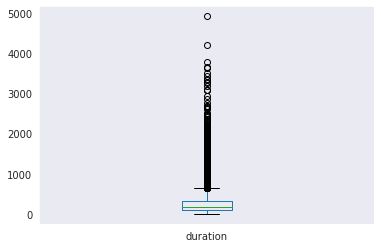

In [31]:
# age , duration , cons_conf_idx , campaign
plot_boxplot(bank_df, 'duration')

Eliminamos los Outliers

In [32]:
# Creamos una funcion que nos devuelve una lista de los indices de los outliers

def outliers(df , col):
  Q1 = df[col].quantile(0.25)
  Q3 = df[col].quantile(0.70)
  IQR = Q3 - Q1

  lower_bound = Q1 - 1.5 * IQR
  upper_bound = Q3 + 1.5 * IQR

  lista = df.index[ (df[col] < lower_bound) | (df[col] > upper_bound )]

  return lista 

In [33]:
# Creamos una lista vacía para almacenar los indices de los outputs de nuestras multiples columnas

index_lista = []
for column in ['age' , 'duration' , 'cons_conf_idx' , 'campaign' ]:
  index_lista.extend(outliers(bank_df , column))

In [34]:
# Creamos la funcion "remove" que nos devuelve un dataframe limpio sin outliers

def remove(df , lista):
  lista : sorted(set(lista))
  df = df.drop(lista)
  return df

In [35]:
bank_df_clean = remove(bank_df , index_lista)

In [36]:
bank_df_clean.shape

(33889, 30)

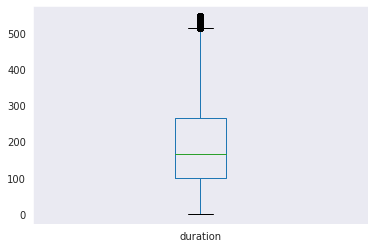

In [37]:
plot_boxplot(bank_df_clean, 'duration')

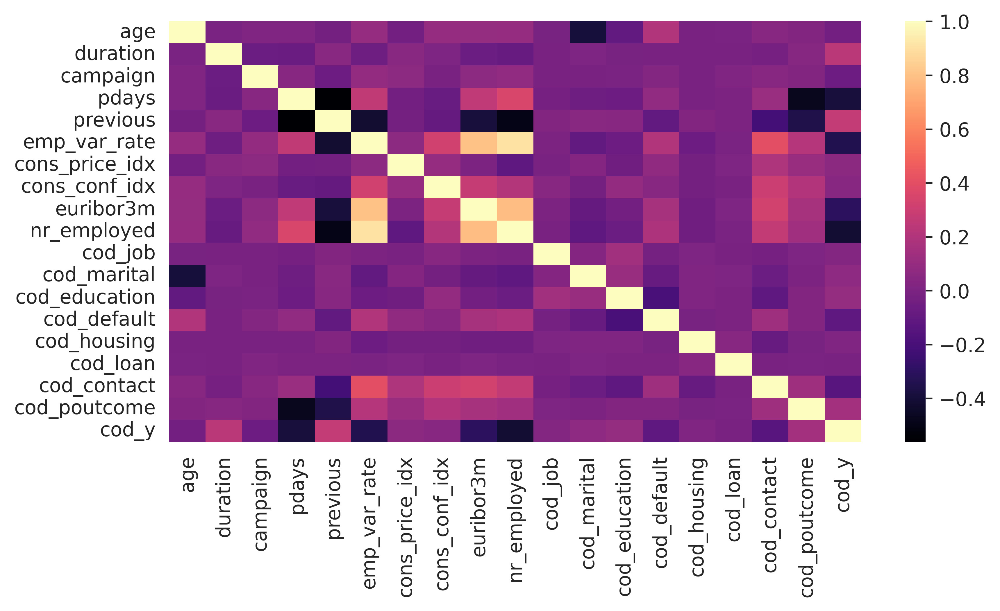

In [38]:
fig = plt.figure(figsize=(8,4), dpi = 480 )
sns.heatmap(bank_df_clean.corr() , cmap='magma')

# **CREACION DE DATAFRAME PARA MODELO**

In [95]:
data_bank = bank_df_clean[['age' , 'cod_job' , 'cod_default' , 'duration', 'cod_contact' , 'pdays' , 'previous' , 'cod_poutcome' , 'cons_conf_idx','cod_y' ]]

In [79]:
#data_bank = bank_df_clean[['age' , 'duration', 'cod_contact' , 'pdays' , 'previous','cod_y' ]]

# **Interpretacion de Clases**

In [96]:
x = data_bank.drop(['cod_y'] , axis=1)
y = data_bank['cod_y']

In [97]:
data_bank['cod_y'].value_counts()

0    31576
1     2313
Name: cod_y, dtype: int64

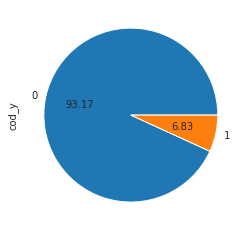

In [98]:
data_bank['cod_y'].value_counts().plot.pie(autopct='%.2f')

## **Data Split**

In [99]:
from sklearn.model_selection import train_test_split

x_train , x_test , y_train , y_test = train_test_split(x , y, test_size=0.2 , random_state=42)

In [100]:
x_train.shape , y_train.shape , x_test.shape , y_test.shape

((27111, 9), (27111,), (6778, 9), (6778,))

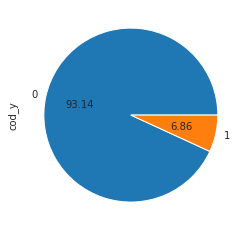

In [101]:
y_train.value_counts().plot.pie(autopct='%.2f')

## **Balance de Clases**

## RUS : RandomUnderSampler

In [102]:
pip install -U imbalanced-learn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Using cached imbalanced_learn-0.9.1-py3-none-any.whl (199 kB)


Text(0.5, 1.0, 'Under-Sampling')

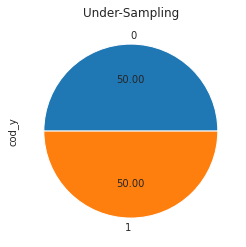

In [103]:
from imblearn.under_sampling import RandomUnderSampler

rus = RandomUnderSampler(sampling_strategy=1) #Valor Numerico
x_train_rus , y_train_rus = rus.fit_resample(x_train , y_train)

ax = y_train_rus.value_counts().plot.pie(autopct='%.2f')
ax.set_title('Under-Sampling')

In [104]:
y_train_rus.value_counts()

0    1860
1    1860
Name: cod_y, dtype: int64

## ROS: RandomOverSampler

Text(0.5, 1.0, 'Over-Sampling')

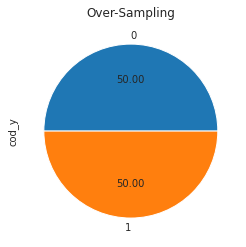

In [105]:
from imblearn.over_sampling import  RandomOverSampler

ros = RandomOverSampler(sampling_strategy='not majority') #Valor Numerico
x_train_ros , y_train_ros = ros.fit_resample(x_train , y_train)

ax = y_train_ros.value_counts().plot.pie(autopct='%.2f')
ax.set_title('Over-Sampling')

In [106]:
y_train_ros.value_counts()

0    25251
1    25251
Name: cod_y, dtype: int64

# **CREACION MODELO CON Y SIN BALANCEO**

**1. Modelo sin balanceo**

In [107]:
# Entrenar Modelo de Random Forest

from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier(random_state=42)
model.fit(x_train , y_train)

# Entrenar Modelo de Cross Validation
from sklearn.metrics import make_scorer , recall_score , matthews_corrcoef
from sklearn.model_selection import cross_validate

model_cv = RandomForestClassifier(random_state=42)
cv_scoring = {'MCC': make_scorer(matthews_corrcoef)}
cv = cross_validate(model_cv , x_train , y_train , cv=5 , scoring=cv_scoring)

# Aplicamos modelo para generar Predicciones
from sklearn.metrics import matthews_corrcoef

y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

mcc_train = matthews_corrcoef(y_train , y_train_pred)
mcc_test = matthews_corrcoef(y_test , y_test_pred)
mcc_cv = cv['test_MCC'].mean()

# Mostrar resultado de la performance del modelo
df_labels = pd.Series(['MCC_train' , 'MCC_CV' , 'MCC_test'], name = 'Performance_metric_names')
df_values = pd.Series([mcc_train , mcc_cv , mcc_test] , name = 'Performance_metric_values')
df1 = pd.concat([df_labels , df_values] , axis=1)
df1






,Performance_metric_names,Performance_metric_values
0,MCC_train,0.997978
1,MCC_CV,0.509341
2,MCC_test,0.522415


2. Modelo con Balanceo Undersampled

In [108]:
# Entrenar Modelo de Random Forest

from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier(random_state=42)
model.fit(x_train_rus , y_train_rus)

# Entrenar Modelo de Cross Validation
from sklearn.metrics import make_scorer , recall_score , matthews_corrcoef
from sklearn.model_selection import cross_validate

model_cv = RandomForestClassifier(random_state=42)
cv_scoring = {'MCC': make_scorer(matthews_corrcoef)}
cv = cross_validate(model_cv , x_train_rus , y_train_rus , cv=5 , scoring=cv_scoring)

# Aplicamos modelo para generar Predicciones
from sklearn.metrics import matthews_corrcoef

y_train_pred = model.predict(x_train_rus)
y_test_pred = model.predict(x_test)

mcc_train = matthews_corrcoef(y_train_rus , y_train_pred)
mcc_test = matthews_corrcoef(y_test , y_test_pred)
mcc_cv = cv['test_MCC'].mean()

# Mostrar resultado de la performance del modelo
df_labels = pd.Series(['MCC_train' , 'MCC_CV' , 'MCC_test'], name = 'Performance_metric_names')
df_values = pd.Series([mcc_train , mcc_cv , mcc_test] , name = 'Performance_metric_values')
df2 = pd.concat([df_labels , df_values] , axis=1)
df2

,Performance_metric_names,Performance_metric_values
0,MCC_train,0.999463
1,MCC_CV,0.742231
2,MCC_test,0.494039


3. Modelo con Balanceo Oversampled

In [109]:
# Entrenar Modelo de Random Forest

from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier(random_state=42)
model.fit(x_train_ros , y_train_ros)

# Entrenar Modelo de Cross Validation
from sklearn.metrics import make_scorer , recall_score , matthews_corrcoef
from sklearn.model_selection import cross_validate

model_cv = RandomForestClassifier(random_state=42)
cv_scoring = {'MCC': make_scorer(matthews_corrcoef)}
cv = cross_validate(model_cv , x_train_ros , y_train_ros , cv=5 , scoring=cv_scoring)

# Aplicamos modelo para generar Predicciones
from sklearn.metrics import matthews_corrcoef

y_train_pred = model.predict(x_train_ros)
y_test_pred = model.predict(x_test)

mcc_train = matthews_corrcoef(y_train_ros , y_train_pred)
mcc_test = matthews_corrcoef(y_test , y_test_pred)
mcc_cv = cv['test_MCC'].mean()

# Mostrar resultado de la performance del modelo
df_labels = pd.Series(['MCC_train' , 'MCC_CV' , 'MCC_test'], name = 'Performance_metric_names')
df_values = pd.Series([mcc_train , mcc_cv , mcc_test] , name = 'Performance_metric_values')
df3 = pd.concat([df_labels , df_values] , axis=1)
df3

,Performance_metric_names,Performance_metric_values
0,MCC_train,0.999762
1,MCC_CV,0.963634
2,MCC_test,0.529188


Mostramos en Conjunto

In [110]:
Modelos_conjunto = pd.concat([df1.Performance_metric_values,
                              df2.Performance_metric_values,
                              df3.Performance_metric_values,] , axis=1)
Modelos_conjunto.columns = ['Sin Balanceo' , 'Balanceo Undersampling' , 'BalanceoOversampling']
Modelos_conjunto = Modelos_conjunto.T
Modelos_conjunto.columns = ['Training' , 'CV' , 'Test' ]
Modelos_conjunto

,Training,CV,Test
Sin Balanceo,0.997978,0.509341,0.522415
Balanceo Undersampling,0.999463,0.742231,0.494039
BalanceoOversampling,0.999762,0.963634,0.529188


# **CREACION DE NUEVO DATAFRAME**

In [ ]:
data_bank = bank_df[['age' , 'job' , 'default' , 'duration', 'contact' , 'campaign' , 'pdays' , 'previous' , 'poutcome' , 'cons_conf_idx','y' ]]

In [ ]:
#new_bank_df = pd.concat([age,job , default , contact , campaign, pdays , previous , poutcome ,y ] , axis=1)

In [ ]:
data_bank

,age,job,default,duration,contact,campaign,pdays,previous,poutcome,cons_conf_idx,y
0,56,housemaid,no,261,telephone,1,30,0,nonexistent,-36.400002,no
1,57,services,unknown,149,telephone,1,30,0,nonexistent,-36.400002,no
2,37,services,no,226,telephone,1,30,0,nonexistent,-36.400002,no
3,40,admin.,no,151,telephone,1,30,0,nonexistent,-36.400002,no
4,56,services,no,307,telephone,1,30,0,nonexistent,-36.400002,no
...,...,...,...,...,...,...,...,...,...,...,...
41171,73,retired,no,334,cellular,1,30,0,nonexistent,-50.799999,yes
41172,46,blue-collar,no,383,cellular,1,30,0,nonexistent,-50.799999,no
41173,56,retired,no,189,cellular,2,30,0,nonexistent,-50.799999,no
41174,44,technician,no,442,cellular,1,30,0,nonexistent,-50.799999,yes


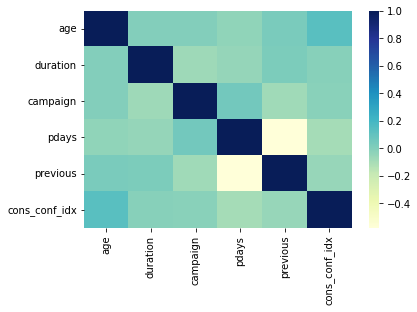

In [ ]:
sns.heatmap(data_bank.corr() , cmap='YlGnBu')

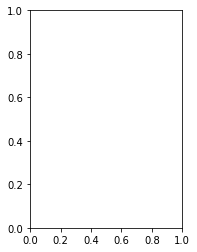

In [ ]:
plt.subplot(1,2,1)
data_bank['y'].hist
data_bank['contact'].hist
plt.show()

# **5.1. Visualizacion y busqueda de correlaciones**

In [ ]:
#sns.heatmap(bank_df.corr() , cmap='magma')

In [ ]:
#sns.countplot(x ='job', data = bank_df , hue='y')

In [ ]:
#sns.countplot(x ='job', data = bank_df , hue='y')

## ¿En que meses estaba más alto el Indice de Confianza?

In [ ]:
sort_order = ['january' , 'february' , 'march' , 'april' , 'may' , 'june' , 'july' , 'august' , 'september' , 'october' , 'november' , 'december']

In [ ]:
Month_df = pd.CategoricalIndex(df['month'] , categories=sort_order , ordered=True)

NameError: ignored

In [ ]:
yes_clients['month']

In [ ]:
vals_to_replace = {'may':'may', 'aug':'august', 'jul':'july', 'jun':'june', 'apr':'april', 'nov':'november', 'oct':'october', 'mar':'march', 'sep':'september', 'dec':'december'}
yes_clients['month'] = yes_clients['month'].map(vals_to_replace)

In [ ]:
yes_clients['month'].value_counts()

In [ ]:
from calendar import month_name
month_lookup = list(month_name)
months = yes_clients['month']
sorted(months, key=month_lookup.index)

In [ ]:
#yes_clients['month'].value_counts()

ax = sns.lineplot(x='month' , y= 'cons_conf_idx' , data = yes_clients)

## ¿En que rango estaba el Indice de Confianza cuando el Cliente dijo SI?

# random

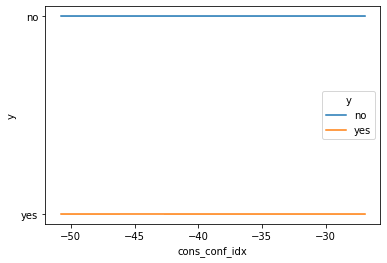

In [ ]:
# Simple Grafico de Linea
# Quiero investigar la relacion entre 'age' e 'y'
ax = sns.lineplot(x='cons_conf_idx' , y= 'y' , data = bank_df , hue = 'y')

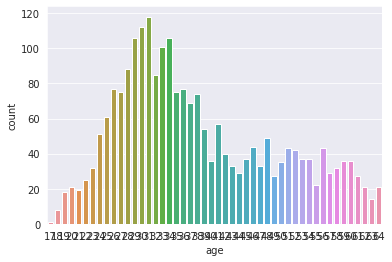

In [ ]:
sns.countplot(x ='age', data = yes_clients)

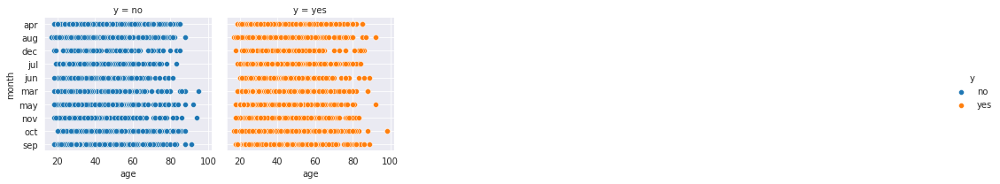

In [ ]:
#grid = sns.FacetGrid(bank_df, col = "y", hue = "y", col_wrap=5)
#grid.map(sns.scatterplot, "age", "month")

#grid.add_legend()

#plt.show()

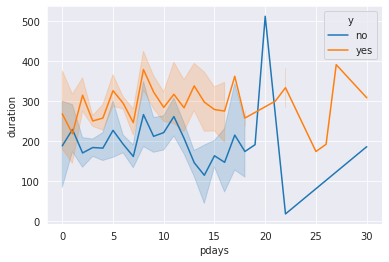

In [ ]:
# Simple Grafico de Linea
# Quiero investigar la relacion entre 'age' e 'y'

ax = sns.lineplot(x='pdays' , y= 'duration' , data = bank_df_clean , hue='y' )

In [ ]:
# Correlacion Positiva
#klib.corr_plot(bank_df_clean , split='pos' , annot = False )